In [67]:
import time
import datetime

import random
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# from time import time
# from time import sleep
# from time import strftime
# from time import localtime


from bs4 import BeautifulSoup

In [68]:
# STOPWATCH
def stopwatch(func):
    def wrapper(*args, **kwargs):
        start = time.time()
        func(*args, **kwargs)
        print('Function took:', time.time() - start, "secs")

    return wrapper


# LOGGER (+ STOPWATCH)
def logger(func):
    def wrapper(*args, **kwargs):
        with open('logs.txt', 'w') as file:
            file.write("Called function with [" + " ".join([str(arg) for arg in args]) + "] at " + str(datetime.datetime.now()) + "\n")
        val = func(*args, **kwargs)
        return val

    return wrapper

In [69]:
@logger
@stopwatch
def addd(a,b):
    print(a+b)




addd(4,5)

9
Function took: 0.0 secs


In [70]:
def streak_counter(llist):
  result_dict = {
    ### 0 for Loss
    0: [],
    ### 1 for Win 
    1: []    
  }

  streak_size = 1

  for i in range(len(llist)):
    if i != len(llist)-1:
      if llist[i] != llist[i+1]:
        result_dict[llist[i]].append(streak_size)
        streak_size = 1

      elif llist[i] == llist[i+1]:
        streak_size += 1
    else:
      result_dict[llist[i]].append(streak_size)

  return result_dict


In [71]:
### function for calulating the average of number of consecutive results
def avg_cal(ddict):
  return np.mean(ddict[0]), np.mean(ddict[1])



In [84]:
### streak generator
#### using list.extend

def streak_gen(streak_size, result_size):    ### number of games
  result_streak = []

  n_games = result_size

  n_games_played = 0

  while n_games_played <= n_games:

    streak_size = streak_size
    streak = random.choices(['WS','LS'], weights=(0.5,0.5))[0]

    if streak == 'WS':
      wr = 0.85
      lr = 0.15
      # print(lr,wr)
      
      streak_games = random.choices([0,1], weights=(lr, wr), k=streak_size)
      result_streak.extend(streak_games)

    else:
      wr = 0.15
      lr = 0.85
      # print(lr,wr)
      streak_games = random.choices([0,1], weights=(lr, wr), k=streak_size)
      result_streak.extend(streak_games)

    n_games_played += streak_size


  return result_streak[:result_size]

In [81]:
%%time
### when it is actually 50:50 (independent)
#### 3000 games per player, 1000 players, totalling 3 million games played

avg_list_0 = []
avg_list_1 = []

result_series = []
for _ in range(1000):
    result_n = random.choices([0,1], k=3000)
    
    result_series.append(pd.Series(result_n))

    streak_counter_result = streak_counter(result_n)
    # print(streak_counter_result)

    avg_cal_result = avg_cal(streak_counter_result)
    # print(avg_cal_result)
    avg_list_0.append(avg_cal_result[0])
    avg_list_1.append(avg_cal_result[1])

Wall time: 1.28 s


In [82]:
print(np.mean(avg_list_0))
print(np.mean(avg_list_1))

2.0004614032097665
1.999120396135194


In [75]:
# data = np.array()
data = np.array(result_series)


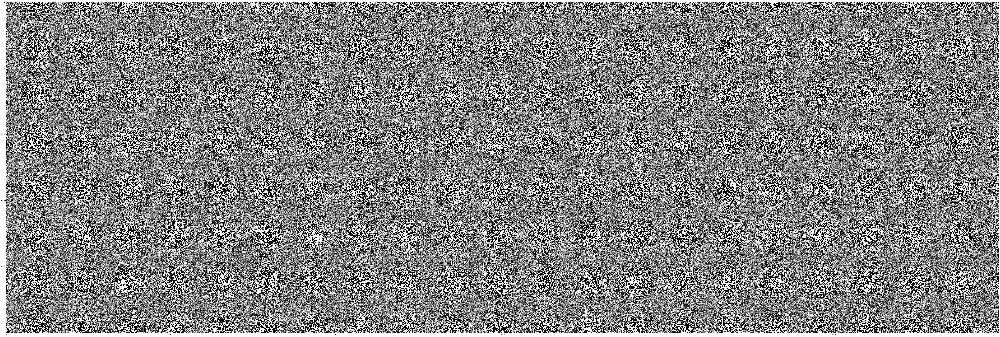

In [76]:
plt.figure(figsize=(100,100))
# plt.imshow(data, cmap='viridis')
# plt.imshow(data)
plt.imshow(result_series, cmap='binary')
plt.show()

In [83]:
%%time

prob_list = np.linspace(0.49,0.51, 100)

### when each game is between 49 ~ 51 % (independent)
#### 3000 games per player, 1000 players, totalling 3 million games played

avg_list_0 = []
avg_list_1 = []

result_series = []
for _ in range(1000):
    result_n = []

    for _ in range(3000):
        prob_of_0 = random.choice(prob_list)
        prob_of_1 = 1 - prob_of_0

        one_game = np.random.choice([0,1], 1, p = [prob_of_0, prob_of_1])[0]
        result_n.append(one_game)
        
    result_series.append(pd.Series(result_n))
    
    streak_counter_result = streak_counter(result_n)
    # print(streak_counter_result)

    avg_cal_result = avg_cal(streak_counter_result)
    # print(avg_cal_result)
    avg_list_0.append(avg_cal_result[0])
    avg_list_1.append(avg_cal_result[1])

Wall time: 56.8 s


In [78]:
print(np.mean(avg_list_0))
print(np.mean(avg_list_1))

1.9999806949564205
1.9975923713436428


In [79]:
# data = np.array()
data = np.array(result_series)


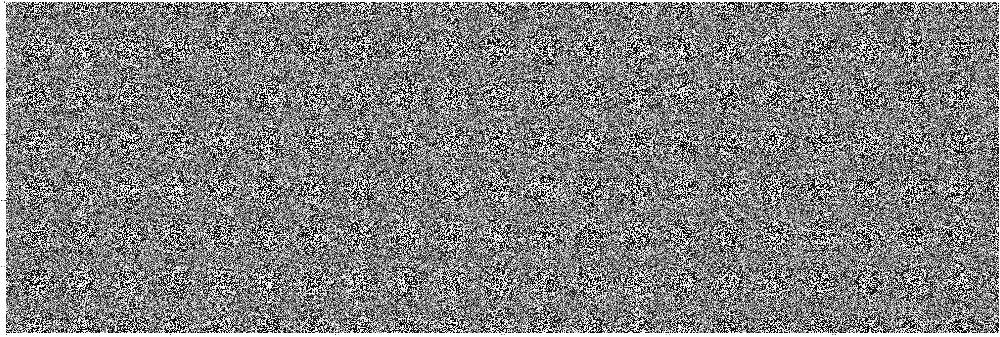

In [80]:
%%time

plt.figure(figsize=(100,100))
# plt.imshow(data, cmap='viridis')
# plt.imshow(data)
plt.imshow(result_series, cmap='binary')
plt.show()

In [89]:
%%time

### when streaks exist
### ws:ls = 50:50
### 85% of win/loss depending on the streak

avg_list_0 = []
avg_list_1 = []

result_series = []
for _ in range(1000):
    result_n = streak_gen(6, 3000)     # 3000 games played per player
    
    result_series.append(pd.Series(result_n))
    
    streak_counter_result = streak_counter(result_n)
    # print(streak_counter_result)

    avg_cal_result = avg_cal(streak_counter_result)
    # print(avg_cal_result)
    avg_list_0.append(avg_cal_result[0])
    avg_list_1.append(avg_cal_result[1])

Wall time: 2.45 s


In [90]:
print(np.mean(avg_list_0))
print(np.mean(avg_list_1))

3.3789384526697135
3.3911334017352766


In [91]:
# data = np.array()
data = np.array(result_series)


In [100]:
%%time

plt.figure(figsize=(100,100))
# plt.imshow(data, cmap='viridis')
# plt.imshow(data)
plt.imshow(result_series, cmap='magma')
plt.show()

Wall time: 9.12 s


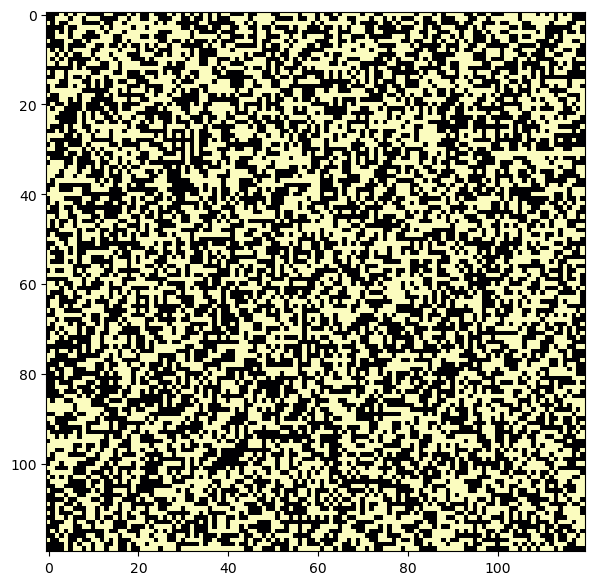

Wall time: 94.6 ms


In [120]:
%%time
### when it is actually 50:50 (independent)
#### 3000 games per player, 1000 players, totalling 3 million games played

avg_list_0 = []
avg_list_1 = []

result_series = []
for _ in range(120):    # number players
    result_n = random.choices([0,1], k=120)    # number of games played per player
    
    result_series.append(pd.Series(result_n))

    streak_counter_result = streak_counter(result_n)
    # print(streak_counter_result)

    avg_cal_result = avg_cal(streak_counter_result)
    # print(avg_cal_result)
    avg_list_0.append(avg_cal_result[0])
    avg_list_1.append(avg_cal_result[1])
    
# data = np.array()
data = np.array(result_series)


plt.figure(figsize=(7,7))
# plt.imshow(data, cmap='viridis')
# plt.imshow(data)
plt.imshow(result_series, cmap='magma')
plt.show()

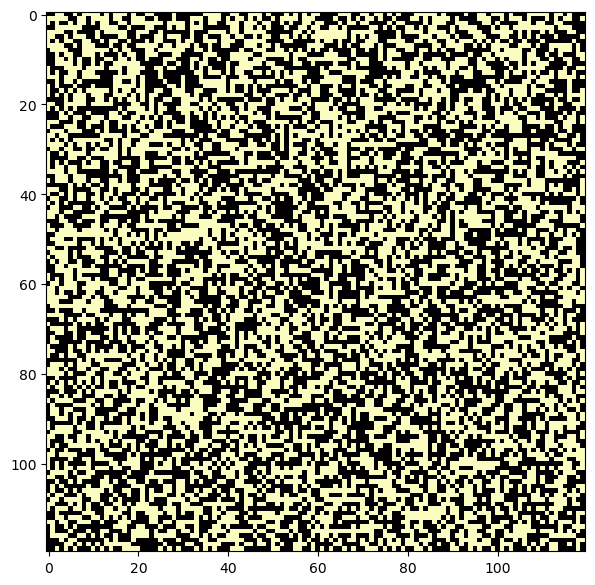

Wall time: 351 ms


In [121]:
%%time

prob_list = np.linspace(0.49,0.51, 100)

### when each game is between 49 ~ 51 % (independent)

avg_list_0 = []
avg_list_1 = []

result_series = []
for _ in range(120):    # number of players
    result_n = []

    for _ in range(120):    # number of games played per player
        prob_of_0 = random.choice(prob_list)
        prob_of_1 = 1 - prob_of_0

        one_game = np.random.choice([0,1], 1, p = [prob_of_0, prob_of_1])[0]
        result_n.append(one_game)
        
    result_series.append(pd.Series(result_n))
    
    streak_counter_result = streak_counter(result_n)
    # print(streak_counter_result)

    avg_cal_result = avg_cal(streak_counter_result)
    # print(avg_cal_result)
    avg_list_0.append(avg_cal_result[0])
    avg_list_1.append(avg_cal_result[1])
    
# data = np.array()
data = np.array(result_series)

plt.figure(figsize=(7,7))
# plt.imshow(data, cmap='viridis')
# plt.imshow(data)
plt.imshow(result_series, cmap='magma')
plt.show()


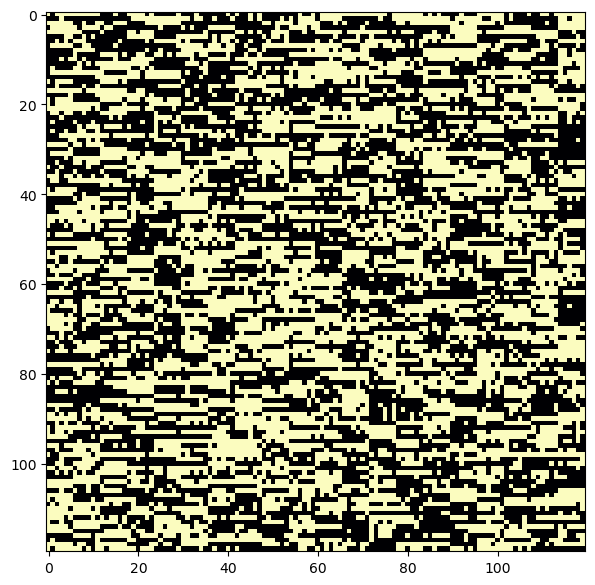

Wall time: 100 ms


In [127]:
%%time

### when streaks exist
### ws:ls = 50:50
### 85% of win/loss depending on the streak

avg_list_0 = []
avg_list_1 = []

result_series = []
for _ in range(120):                  # number of players
    result_n = streak_gen(6, 120)     # number of games played per player
    
    result_series.append(pd.Series(result_n))
    
    streak_counter_result = streak_counter(result_n)
    # print(streak_counter_result)

    avg_cal_result = avg_cal(streak_counter_result)
    # print(avg_cal_result)
    avg_list_0.append(avg_cal_result[0])
    avg_list_1.append(avg_cal_result[1])
    

# data = np.array()
data = np.array(result_series)

    


plt.figure(figsize=(7,7))
# plt.imshow(data, cmap='viridis')
# plt.imshow(data)
plt.imshow(result_series, cmap='magma')
plt.show()